<a href="https://colab.research.google.com/github/Jyotirmoy-99/Physics/blob/main/youngs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

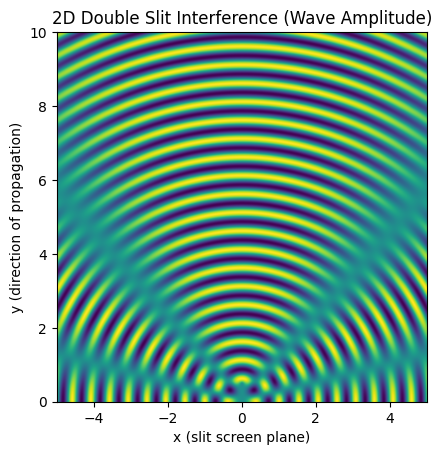

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit_distance = 1.0
x = np.linspace(-5, 5, 400)
y = np.linspace(0, 10, 400)
X, Y = np.meshgrid(x, y)

# Slit positions
slit1 = np.array([0, 0.5 * slit_distance])
slit2 = np.array([0, -0.5 * slit_distance])

# Distance from slits to each (X, Y) point
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Initial plot
fig, ax = plt.subplots()
ax.set_title("2D Double Slit Interference (Wave Amplitude)")
wave_img = ax.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                     cmap='viridis', origin='lower', vmin=-2, vmax=2)
plt.xlabel("x (slit screen plane)")
plt.ylabel("y (direction of propagation)")

def update(frame):
    t = frame / 10
    wave1 = np.sin(k * r1 - omega * t)
    wave2 = np.sin(k * r2 - omega * t)
    superposed = wave1 + wave2
    wave_img.set_data(superposed)
    return [wave_img]

ani = animation.FuncAnimation(fig, update, frames=200, interval=50, blit=True)
plt.show()


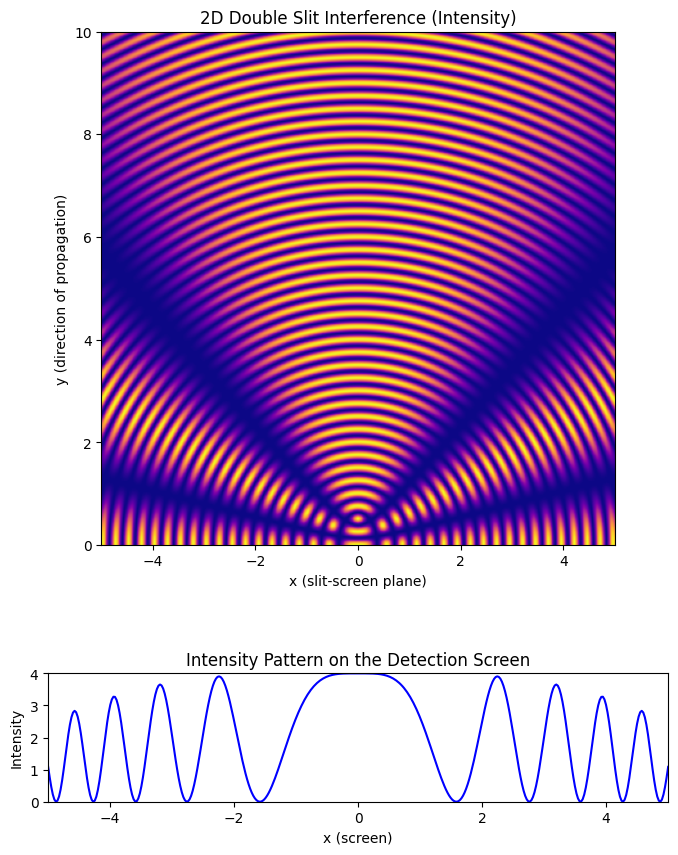

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Parameters
wavelength = 0.5
k = 2 * np.pi / wavelength  # wave number
omega = 2 * np.pi  # angular frequency
slit_distance = 1.0

# Simulation grid
x = np.linspace(-5, 5, 400)
y = np.linspace(0, 10, 400)
X, Y = np.meshgrid(x, y)

# Slit positions (in y)
slit1 = np.array([0, 0.5 * slit_distance])
slit2 = np.array([0, -0.5 * slit_distance])

# Distances from slits
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# --- Setup the figure and axes ---
fig, (ax_main, ax_screen) = plt.subplots(2, 1, figsize=(8, 10), gridspec_kw={'height_ratios': [4, 1]})
plt.subplots_adjust(hspace=0.4)

# Main interference pattern
img = ax_main.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                     cmap='plasma', origin='lower', vmin=0, vmax=4)
ax_main.set_title("2D Double Slit Interference (Intensity)")
ax_main.set_xlabel("x (slit-screen plane)")
ax_main.set_ylabel("y (direction of propagation)")

# Screen slice (intensity at y ≈ 10)
line, = ax_screen.plot([], [], color='blue')
ax_screen.set_xlim(x.min(), x.max())
ax_screen.set_ylim(0, 4)
ax_screen.set_title("Intensity Pattern on the Detection Screen")
ax_screen.set_xlabel("x (screen)")
ax_screen.set_ylabel("Intensity")

# --- Animation update function ---
def update(frame):
    t = frame / 10
    wave1 = np.cos(k * r1 - omega * t)
    wave2 = np.cos(k * r2 - omega * t)
    superposed = wave1 + wave2
    intensity = superposed**2

    # Update main plot
    img.set_data(intensity)

    # Update screen pattern (top row, y ≈ 10)
    intensity_at_screen = intensity[-1, :]  # top row
    line.set_data(x, intensity_at_screen)

    return [img, line]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=200, interval=50, blit=True)

plt.show()


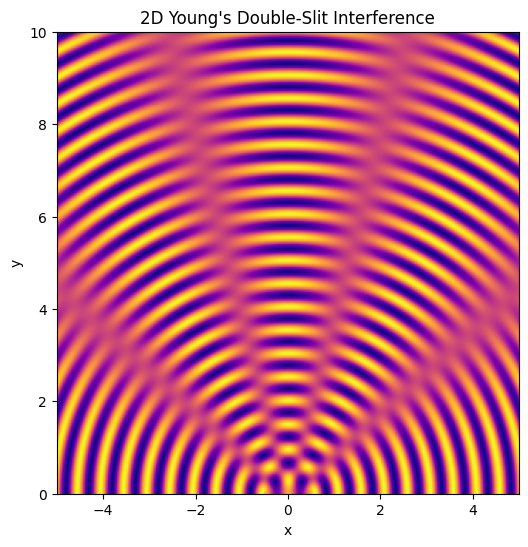

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit_distance = 1.0

# Grid
x = np.linspace(-5, 5, 300)
y = np.linspace(0, 10, 300)
X, Y = np.meshgrid(x, y)

# Slit positions
slit1 = [-0.5, 0]
slit2 = [0.5, 0]

# Distance from slits
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Setup plot
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_title("2D Young's Double-Slit Interference")
ax.set_xlabel("x")
ax.set_ylabel("y")

img = ax.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                cmap='plasma', origin='lower', vmin=-2, vmax=2)

# Animation function
def update(frame):
    t = frame / 10.0
    wave1 = np.sin(k * r1 - omega * t)
    wave2 = np.sin(k * r2 - omega * t)
    total_wave = wave1 + wave2
    img.set_data(total_wave)
    return [img]

# Create animation
ani = FuncAnimation(fig, update, frames=2000, interval=30, blit=True)

# Display animation in Colab
HTML(ani.to_jshtml())


In [ ]:
video_path = "/content/double_slit.mp4"
ani.save(video_path, writer='ffmpeg', fps=30)



In [ ]:
import os
print("Saved?", os.path.exists("/content/double_slit.mp4"))  # should return True


Saved? True


In [ ]:
from IPython.display import HTML

HTML('<a href="/content/double_slit.mp4" download target="_blank">👉 Click here to download animation</a>')


/content/double_slit.mp4

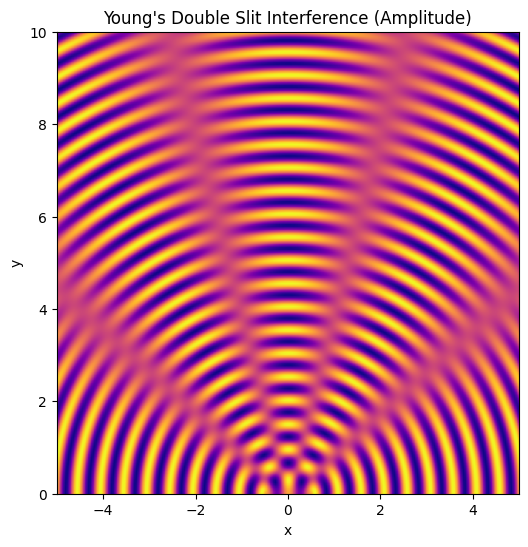

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import FileLink
import os

# (Optional) Install ffmpeg in Colab
!apt-get -y install ffmpeg > /dev/null

# Parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit_distance = 1.0

# Grid
x = np.linspace(-5, 5, 300)
y = np.linspace(0, 10, 300)
X, Y = np.meshgrid(x, y)
slit1 = [-0.5, 0]
slit2 = [0.5, 0]
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_title("Young's Double Slit Interference (Amplitude)")
ax.set_xlabel("x")
ax.set_ylabel("y")
img = ax.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                cmap='plasma', origin='lower', vmin=-2, vmax=2)

def update(frame):
    t = frame / 10.0
    wave1 = np.sin(k * r1 - omega * t)
    wave2 = np.sin(k * r2 - omega * t)
    total_wave = wave1 + wave2
    img.set_data(total_wave)
    return [img]

ani = animation.FuncAnimation(fig, update, frames=200, interval=30, blit=True)

# ✅ Save to a valid path (Colab only allows /content/)
video_path = "/content/double_slit.mp4"
ani.save(video_path, writer='ffmpeg', fps=30)

# ✅ Create download link
FileLink(video_path)


✅ Saved to: /content/double_slit_intensity.mp4


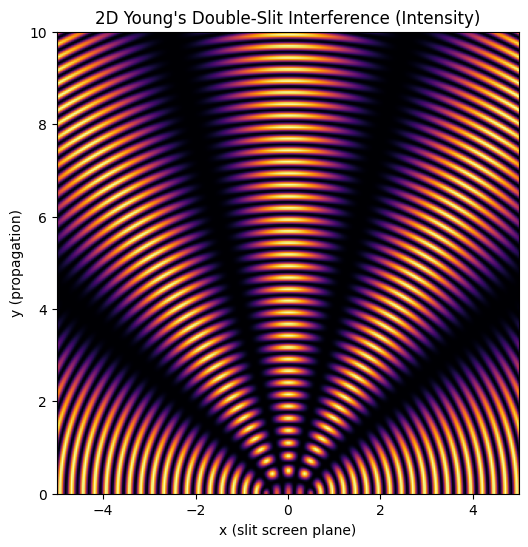

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
import os

# Optional: install ffmpeg for saving animation
!apt-get -y install ffmpeg > /dev/null

# Wave parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit_distance = 1.0

# Grid setup
x = np.linspace(-5, 5, 300)
y = np.linspace(0, 10, 300)
X, Y = np.meshgrid(x, y)

# Slit positions
slit1 = [-0.5, 0]
slit2 = [0.5, 0]
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Plot setup
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_title("2D Young's Double-Slit Interference (Intensity)")
ax.set_xlabel("x (slit screen plane)")
ax.set_ylabel("y (propagation)")
img = ax.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                cmap='inferno', origin='lower', vmin=0, vmax=4)

# Animation update: Intensity = (Amplitude₁ + Amplitude₂)²
def update(frame):
    t = frame / 10.0
    wave1 = np.cos(k * r1 - omega * t)
    wave2 = np.cos(k * r2 - omega * t)
    intensity = (wave1 + wave2) ** 2
    img.set_data(intensity)
    return [img]

# Animate
ani = animation.FuncAnimation(fig, update, frames=200, interval=30, blit=True)

# Save as MP4
video_path = "/content/double_slit_intensity.mp4"
ani.save(video_path, writer='ffmpeg', fps=30)

# Download link (use this if automatic display doesn't work)
print("✅ Saved to:", video_path)


/content/youngs_double_slit_combined_cos.mp4

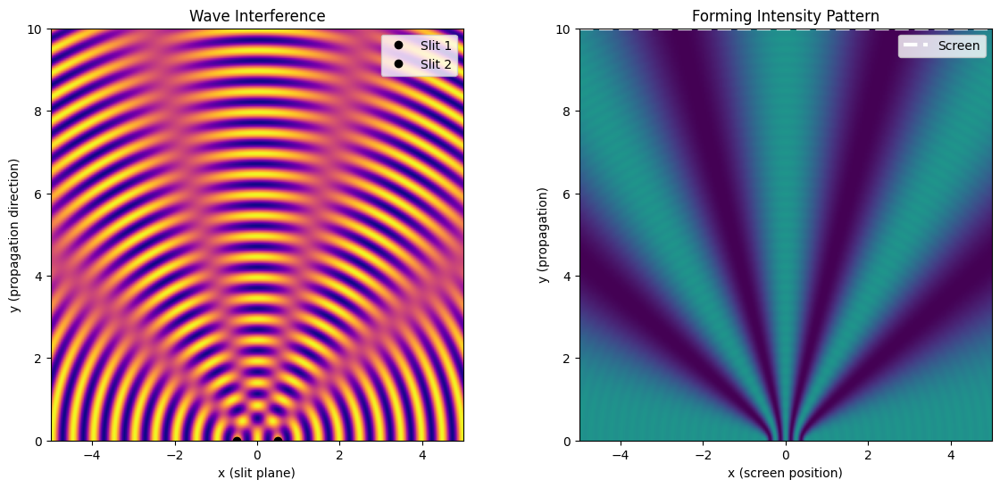

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import FileLink
import os

# Ensure ffmpeg is available
!apt-get -y install ffmpeg > /dev/null

# Parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit1 = [-0.5, 0]
slit2 = [0.5, 0]

# Grid
x = np.linspace(-5, 5, 300)
y = np.linspace(0, 10, 300)
X, Y = np.meshgrid(x, y)

# Distance to each slit
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Setup figure with two panels
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# --- Wave Plot ---
wave_img = ax1.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                      cmap='plasma', origin='lower', vmin=-2, vmax=2)
ax1.set_title("Wave Interference")
ax1.set_xlabel("x (slit plane)")
ax1.set_ylabel("y (propagation direction)")
ax1.plot(slit1[0], slit1[1], 'ko', label="Slit 1")
ax1.plot(slit2[0], slit2[1], 'ko', label="Slit 2")
ax1.legend(loc="upper right")

# --- Intensity Plot ---
intensity_img = ax2.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                           cmap='viridis', origin='lower', vmin=0, vmax=4)
ax2.set_title("Forming Intensity Pattern")
ax2.set_xlabel("x (screen position)")
ax2.set_ylabel("y (propagation)")
ax2.axhline(y=10, color='white', linestyle='--', linewidth=2, label='Screen')
ax2.legend(loc="upper right")

# Animation function
# Initialize intensity accumulation array
accumulated_intensity = np.zeros_like(X)

def update(frame):
    global accumulated_intensity
    t = frame / 25
    wave1 = np.cos(k * r1 - omega * t)
    wave2 = np.cos(k * r2 - omega * t)
    total_wave = wave1 + wave2
    instantaneous_intensity = total_wave**2

    # Accumulate intensity
    accumulated_intensity += instantaneous_intensity

    # Normalize for display (optional)
    normalized_intensity = accumulated_intensity / (frame + 1)

    wave_img.set_data(total_wave)
    intensity_img.set_data(normalized_intensity)
    return [wave_img, intensity_img]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=150, interval=30, blit=True)

# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)

# Show download link
FileLink(out_path)


/content/youngs_double_slit_combined_cos_lab.mp4

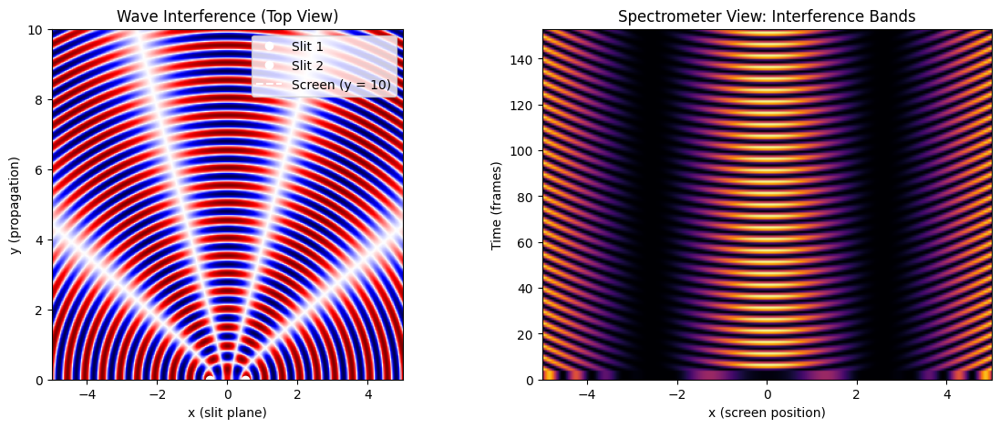

In [ ]:
# Young's Double Slit Experiment: Spectrometer View (Modified to show bands)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Wave parameters
wavelength = 0.5                      # Monochromatic light wavelength
k = 2 * np.pi / wavelength            # Wave number
omega = 2 * np.pi                    # Angular frequency (assume unit time scale)
slit1 = [-0.5, 0]                    # Left slit position
slit2 = [0.5, 0]                     # Right slit position

# Create a 2D grid to simulate wave propagation
x = np.linspace(-5, 5, 300)          # x-axis: screen width
y = np.linspace(0, 10, 300)         # y-axis: distance from slits to screen
X, Y = np.meshgrid(x, y)            # Create coordinate grid

# Calculate distances from each slit to every point on the grid
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Create figure with two subplots
fig, (ax_wave, ax_bands) = plt.subplots(1, 2, figsize=(14, 5))

# LEFT PLOT: Top-down 2D wave interference visualization
wave_img = ax_wave.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                          cmap='seismic', origin='lower', vmin=-2, vmax=2)
ax_wave.set_title("Wave Interference (Top View)")
ax_wave.set_xlabel("x (slit plane)")
ax_wave.set_ylabel("y (propagation)")
ax_wave.plot(slit1[0], slit1[1], 'wo', label="Slit 1")
ax_wave.plot(slit2[0], slit2[1], 'wo', label="Slit 2")
ax_wave.axhline(y=10, color='white', linestyle='--', label="Screen (y = 10)")
ax_wave.legend(loc="upper right")

# RIGHT PLOT: Simulated spectrometer view (intensity bands as 2D heatmap)
band_img = ax_bands.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                           cmap='inferno', origin='lower', vmin=0, vmax=4, aspect='auto')
ax_bands.set_title("Spectrometer View: Interference Bands")
ax_bands.set_xlabel("x (screen position)")
ax_bands.set_ylabel("Time (frames)")

# Create buffer to hold band evolution over time
intensity_band_evolution = []

# Animation update function
def update(frame):
    global intensity_band_evolution
    t = frame / 10.0
    wave1 = np.sin(k * r1 - omega * t)
    wave2 = np.sin(k * r2 - omega * t)
    total_wave = wave1 + wave2
    instantaneous_intensity = total_wave ** 2

    # Capture intensity at y = 10 (screen position)
    screen_index = np.argmin(np.abs(y - 10))
    intensity_band_evolution.append(instantaneous_intensity[screen_index])

    # Stack bands as time series (latest at bottom)
    band_stack = np.array(intensity_band_evolution[-300:])  # limit height to 300
    band_img.set_data(band_stack)
    band_img.set_extent([x.min(), x.max(), 0, band_stack.shape[0]])

    # Update wave plot
    wave_img.set_data(total_wave)

    return [wave_img, band_img]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=150, interval=30, blit=True)

# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos_lab.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)

# Show download link
FileLink(out_path)


/content/youngs_double_slit_combined_cos_lab{1}.mp4

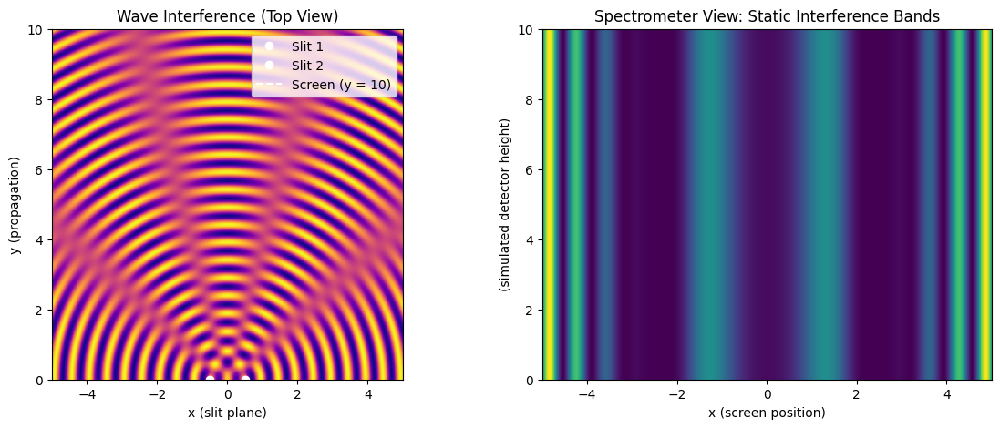

In [ ]:
# Young's Double Slit Experiment: Spectrometer View (Realistic Static Bands)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Wave parameters
wavelength = 0.5                      # Monochromatic light wavelength
k = 2 * np.pi / wavelength            # Wave number
omega = 2 * np.pi                    # Angular frequency (assume unit time scale)
slit1 = [-0.5, 0]                    # Left slit position
slit2 = [0.5, 0]                     # Right slit position

# Create a 2D grid to simulate wave propagation
x = np.linspace(-5, 5, 300)          # x-axis: screen width
y = np.linspace(0, 10, 300)         # y-axis: distance from slits to screen
X, Y = np.meshgrid(x, y)            # Create coordinate grid

# Calculate distances from each slit to every point on the grid
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Create figure with two subplots
fig, (ax_wave, ax_bands) = plt.subplots(1, 2, figsize=(14, 5))

# LEFT PLOT: Top-down 2D wave interference visualization
wave_img = ax_wave.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                          cmap='plasma', origin='lower', vmin=-2, vmax=2)
ax_wave.set_title("Wave Interference (Top View)")
ax_wave.set_xlabel("x (slit plane)")
ax_wave.set_ylabel("y (propagation)")
ax_wave.plot(slit1[0], slit1[1], 'wo', label="Slit 1")
ax_wave.plot(slit2[0], slit2[1], 'wo', label="Slit 2")
ax_wave.axhline(y=10, color='white', linestyle='--', label="Screen (y = 10)")
ax_wave.legend(loc="upper right")

# RIGHT PLOT: Fixed vertical interference bands as seen on screen
screen_index = np.argmin(np.abs(y - 10))
# Time-average intensity pattern (simulate long exposure)
intensity = (np.sin(k * r1 - omega * 0) + np.sin(k * r2 - omega * 0)) ** 2
mean_intensity = intensity[screen_index]  # 1D slice across screen

# Plot static vertical bands
band_img = ax_bands.imshow(np.tile(mean_intensity, (300, 1)), extent=[x.min(), x.max(), 0, 10],
                           cmap='viridis', origin='lower', aspect='auto')
ax_bands.set_title("Spectrometer View: Static Interference Bands")
ax_bands.set_xlabel("x (screen position)")
ax_bands.set_ylabel("(simulated detector height)")

# Animation update function

def update(frame):
    t = frame / 10.0
    wave1 = np.cos(k * r1 - omega * t)
    wave2 = np.cos(k * r2 - omega * t)
    total_wave = wave1 + wave2
    wave_img.set_data(total_wave)
    return [wave_img, band_img]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=150, interval=30, blit=True)

# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos_lab{1}.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)

# Show download link
FileLink(out_path)

/content/youngs_double_slit_combined_cos_lab{1}.mp4

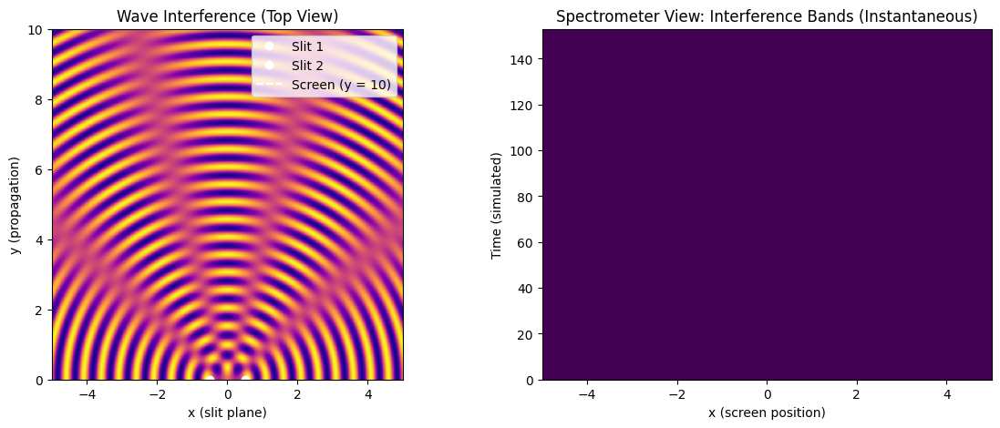

In [ ]:
# Young's Double Slit Experiment: Spectrometer View (Dynamic Instantaneous Bands)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Wave parameters
wavelength = 0.5                      # Monochromatic light wavelength
k = 2 * np.pi / wavelength            # Wave number
omega = 2 * np.pi                    # Angular frequency (assume unit time scale)
slit1 = [-0.5, 0]                    # Left slit position
slit2 = [0.5, 0]                     # Right slit position

# Create a 2D grid to simulate wave propagation
x = np.linspace(-5, 5, 300)          # x-axis: screen width
y = np.linspace(0, 10, 300)         # y-axis: distance from slits to screen
X, Y = np.meshgrid(x, y)            # Create coordinate grid

# Calculate distances from each slit to every point on the grid
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Create figure with two subplots
fig, (ax_wave, ax_bands) = plt.subplots(1, 2, figsize=(14, 5))

# LEFT PLOT: Top-down 2D wave interference visualization
wave_img = ax_wave.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                          cmap='plasma', origin='lower', vmin=-2, vmax=2)
ax_wave.set_title("Wave Interference (Top View)")
ax_wave.set_xlabel("x (slit plane)")
ax_wave.set_ylabel("y (propagation)")
ax_wave.plot(slit1[0], slit1[1], 'wo', label="Slit 1")
ax_wave.plot(slit2[0], slit2[1], 'wo', label="Slit 2")
ax_wave.axhline(y=10, color='white', linestyle='--', label="Screen (y = 10)")
ax_wave.legend(loc="upper right")

# RIGHT PLOT: Dynamic instantaneous intensity at the screen
screen_index = np.argmin(np.abs(y - 10))
intensity_line = np.zeros((300, len(x)))  # to store time-varying intensity
band_img = ax_bands.imshow(intensity_line, extent=[x.min(), x.max(), 0, 10],
                           cmap='viridis', origin='lower', aspect='auto')
ax_bands.set_title("Spectrometer View: Interference Bands (Instantaneous)")
ax_bands.set_xlabel("x (screen position)")
ax_bands.set_ylabel("Time (simulated)")

# Animation update function
frame_buffer = []

def update(frame):
    t = frame / 25.0
    wave1 = np.sin(k * r1 - omega * t)
    wave2 = np.sin(k * r2 - omega * t)
    total_wave = wave1 + wave2
    wave_img.set_data(total_wave)

    # Compute instantaneous intensity on screen
    instantaneous_intensity = (wave1 + wave2)**2
    screen_intensity = instantaneous_intensity[screen_index]  # 1D slice

    # Shift intensity buffer and add new line
    frame_buffer.append(screen_intensity)
    if len(frame_buffer) > 300:
        frame_buffer.pop(0)
    band_img.set_data(np.array(frame_buffer))
    band_img.set_extent([x.min(), x.max(), 0, len(frame_buffer)])

    return [wave_img, band_img]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=150, interval=30, blit=True)

# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos_lab{2}.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)

# Show download link
FileLink(out_path)


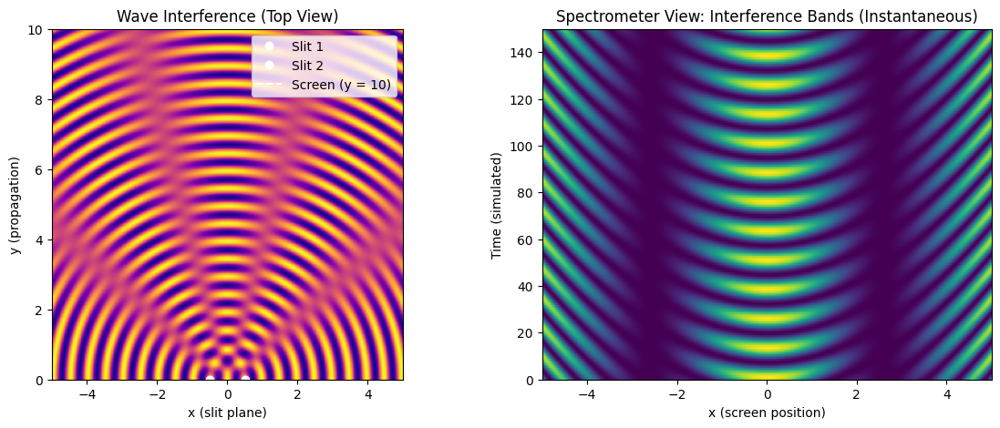

In [ ]:
# Young's Double Slit Experiment: Spectrometer View (Dynamic Instantaneous Bands)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Wave parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit1 = [-0.5, 0]
slit2 = [0.5, 0]

# Grid setup
x = np.linspace(-5, 5, 300)
y = np.linspace(0, 10, 300)
X, Y = np.meshgrid(x, y)

# Distance from slits
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Plot setup
fig, (ax_wave, ax_bands) = plt.subplots(1, 2, figsize=(14, 5))

# Left subplot: wave interference
wave_img = ax_wave.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                          cmap='plasma', origin='lower', vmin=-2, vmax=2)
ax_wave.set_title("Wave Interference (Top View)")
ax_wave.set_xlabel("x (slit plane)")
ax_wave.set_ylabel("y (propagation)")
ax_wave.plot(slit1[0], slit1[1], 'wo', label="Slit 1")
ax_wave.plot(slit2[0], slit2[1], 'wo', label="Slit 2")
ax_wave.axhline(y=10, color='white', linestyle='--', label="Screen (y = 10)")
ax_wave.legend(loc="upper right")

# Right subplot: spectrometer view
screen_index = np.argmin(np.abs(y - 10))
intensity_height = 150
frame_buffer = np.zeros((intensity_height, len(x)))
band_img = ax_bands.imshow(frame_buffer, extent=[x.min(), x.max(), 0, intensity_height],
                           cmap='viridis', origin='lower', aspect='auto', vmin=0, vmax=4)
ax_bands.set_title("Spectrometer View: Interference Bands (Instantaneous)")
ax_bands.set_xlabel("x (screen position)")
ax_bands.set_ylabel("Time (simulated)")

# Animation update
def update(frame):
    t = frame / 25.0
    wave1 = np.cos(k * r1 - omega * t)
    wave2 = np.cos(k * r2 - omega * t)
    total_wave = wave1 + wave2
    wave_img.set_data(total_wave)

    # Intensity at screen
    screen_intensity = (wave1 + wave2)**2
    screen_line = screen_intensity[screen_index]

    # Roll buffer to simulate time
    frame_buffer[:-1] = frame_buffer[1:]
    frame_buffer[-1] = screen_line
    band_img.set_data(frame_buffer)

    return [wave_img, band_img]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=300, interval=30, blit=True)

# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos_lab{3}.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)


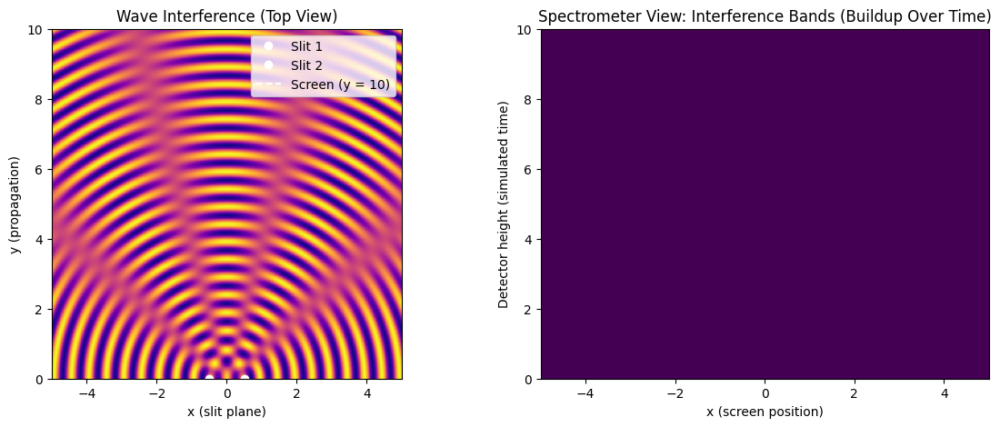

In [ ]:
# Young's Double Slit Experiment: Spectrometer View (Cumulative Build-Up)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Wave parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit1 = [-0.5, 0]
slit2 = [0.5, 0]

# Grid setup
x = np.linspace(-5, 5, 300)           # Screen width
y = np.linspace(0, 10, 300)           # Propagation direction
X, Y = np.meshgrid(x, y)

# Distance from each slit to each grid point
r1 = np.sqrt((X - slit1[0])**2 + (Y - slit1[1])**2)
r2 = np.sqrt((X - slit2[0])**2 + (Y - slit2[1])**2)

# Figure and axes
fig, (ax_wave, ax_spec) = plt.subplots(1, 2, figsize=(14, 5))

# LEFT: Wave Interference Pattern
wave_img = ax_wave.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                          cmap='plasma', origin='lower', vmin=-2, vmax=2)
ax_wave.set_title("Wave Interference (Top View)")
ax_wave.set_xlabel("x (slit plane)")
ax_wave.set_ylabel("y (propagation)")
ax_wave.plot(slit1[0], slit1[1], 'wo', label="Slit 1")
ax_wave.plot(slit2[0], slit2[1], 'wo', label="Slit 2")
ax_wave.axhline(y=10, color='white', linestyle='--', label="Screen (y = 10)")
ax_wave.legend(loc="upper right")

# RIGHT: Spectrometer View — cumulative bands
screen_index = np.argmin(np.abs(y - 10))
accumulated_intensity = np.zeros((150, len(x)))  # 150 frames × x values
band_img = ax_spec.imshow(accumulated_intensity, extent=[x.min(), x.max(), 0, 10],
                          cmap='viridis', origin='lower', aspect='auto')
ax_spec.set_title("Spectrometer View: Interference Bands (Buildup Over Time)")
ax_spec.set_xlabel("x (screen position)")
ax_spec.set_ylabel("Detector height (simulated time)")

# Animation update function
def update(frame):
    t = frame / 10.0
    wave1 = np.cos(k * r1 - omega * t)
    wave2 = np.cos(k * r2 - omega * t)
    total_wave = wave1 + wave2
    wave_img.set_data(total_wave)

    # Calculate intensity on screen and accumulate
    intensity = (wave1 + wave2)**2
    accumulated_intensity[frame, :] = intensity[screen_index]

    band_img.set_data(accumulated_intensity[:frame+1])
    band_img.set_extent([x.min(), x.max(), 0, (frame+1) * (10 / 150)])  # Simulated "detector height"

    return [wave_img, band_img]

# Animate
ani = animation.FuncAnimation(fig, update, frames=150, interval=40, blit=True)

# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos_lab{4}.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)


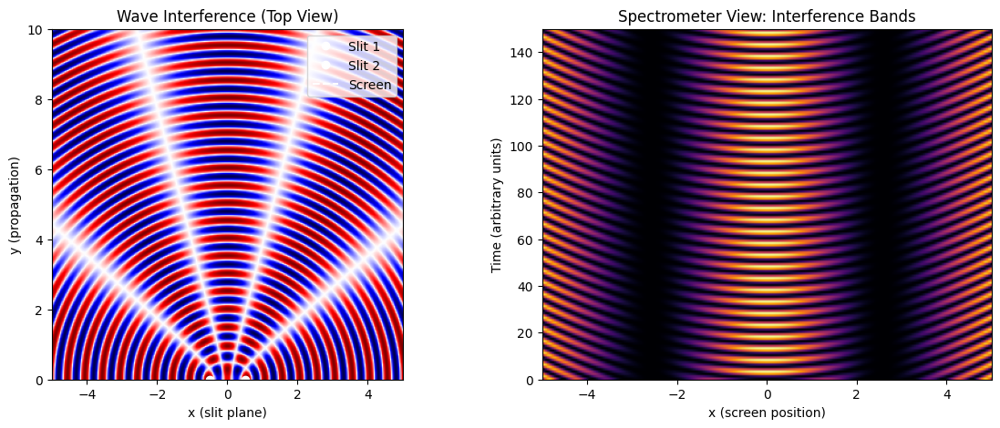

In [ ]:
# Young's Double Slit Experiment: Spectrometer View (Straight Bands Over Time)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Wave parameters
wavelength = 0.5
k = 2 * np.pi / wavelength
omega = 2 * np.pi
slit_distance = 1.0
screen_distance = 10

# Slit positions
slit1 = -slit_distance / 2
slit2 = slit_distance / 2

# Grid for left view (wave propagation)
x = np.linspace(-5, 5, 300)
y = np.linspace(0, 10, 300)
X, Y = np.meshgrid(x, y)

# Distances from slits
r1 = np.sqrt((X - slit1)**2 + Y**2)
r2 = np.sqrt((X - slit2)**2 + Y**2)

# Parameters for animation
num_frames = 150
screen_index = np.argmin(np.abs(y - screen_distance))
intensity_cumulative = np.zeros((num_frames, len(x)))

# Plot setup
fig, (ax_wave, ax_bands) = plt.subplots(1, 2, figsize=(14, 5))

# LEFT: Interference wavefronts
wave_img = ax_wave.imshow(np.zeros_like(X), extent=[x.min(), x.max(), y.min(), y.max()],
                          cmap='seismic', origin='lower', vmin=-2, vmax=2)
ax_wave.set_title("Wave Interference (Top View)")
ax_wave.set_xlabel("x (slit plane)")
ax_wave.set_ylabel("y (propagation)")
ax_wave.plot(slit1, 0, 'wo', label="Slit 1")
ax_wave.plot(slit2, 0, 'wo', label="Slit 2")
ax_wave.axhline(y=screen_distance, color='white', linestyle='--', label="Screen")
ax_wave.legend(loc="upper right")

# RIGHT: Spectrometer view (straight bands building up)
band_img = ax_bands.imshow(intensity_cumulative, extent=[x.min(), x.max(), 0, num_frames],
                           cmap='inferno', origin='lower', aspect='auto', vmin=0, vmax=4)
ax_bands.set_title("Spectrometer View: Interference Bands")
ax_bands.set_xlabel("x (screen position)")
ax_bands.set_ylabel("Time (arbitrary units)")

# Update function
def update(frame):
    t = frame / 10.0
    wave1 = np.sin(k * r1 - omega * t)
    wave2 = np.sin(k * r2 - omega * t)
    total_wave = wave1 + wave2
    wave_img.set_data(total_wave)

    # Capture intensity at screen distance
    intensity = total_wave**2
    intensity_cumulative[frame, :] = intensity[screen_index]
    band_img.set_data(intensity_cumulative)

    return [wave_img, band_img]

# Animation
ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=30, blit=True)
HTML(ani.to_jshtml())



# Save animation to file
out_path = "/content/youngs_double_slit_combined_cos_lab{5}.mp4"
ani.save(out_path, writer='ffmpeg', fps=24)

